# Idea: Review safety/inequality of DC citizens, by reviewing hate crime trends/locations overtime, along with other demographic/inequalty stuff. This can relate to the sustainable development goals relating to [Peace, Justice, and Strong institutions](https://sdg-tracker.org/peace-justice)

   * **Prevalence of all types of violence: 16.1.3**
       * Definition: Indicator 16.1.3 is the proportion of population subjected to (a) physical violence, (b) psychological violence and (c) sexual violence in the previous 12 months.

       * Goal: Significantly reduce all forms of violence and related death rates across all countries by 2030.
   * **Increase public safety: 16.1.4**
       * Definition: Indicator 16.1.4 is the proportion of population that feel safe walking alone around the area they live.

       * Goal: Significantly reduce all forms of violence and related death rates across all countries by 2030.
   * **Public discrimination: 16.B.1**
       * Definition: Indicator 16.B.1 is the proportion of population reporting having personally felt discriminated against or harassed in the previous 12 months on the basis of a ground of discrimination prohibited under international human rights law.
       * Goal: Promote and enforce non-discriminatory laws and policies for sustainable development across all countries by 2030.

> ## * How has violence and public safety evolved in Washington DC? How safe are people in DC? If they protest, are they going to be protected? If they commit a crime, will they be injured by the police? 
> ## * How have hate crimes evolved by type overtime, considering major world events?
> ## * How have hate crimes evolved based on location? Are there certain areas with more? What can we notice about those areas? Are they related to demographics?
> ## * Which groups are the most unsafe?
> ## * minor roadblock that has been solved already: only the police district is included, not lat/long. but the adddress is included so with some manual effort we can extract lat/long from the addresses! [like this](https://towardsdatascience.com/geocode-with-python-161ec1e62b89)
> ## * Analyze police force from 2020
> ## * Need to look at demographics DC

# In use
## Hate crime dataset
* https://mpdc.dc.gov/node/1334781
* DC hate crime instances from 2012-2021 full years
* contains the district (which is a police district), and not a ZIP code.
** Police district geojson is here https://github.com/benbalter/dc-maps/blob/master/maps/police-districts-mpd.geojson

## Use of force dataset
* https://mpdc.dc.gov/node/1582621
* only 2020
* contains the district (which is a police district), and not a ZIP code.
** Police district geojson is here https://github.com/benbalter/dc-maps/blob/master/maps/police-districts-mpd.geojson

# Testing
* Traffic stops 2019(partial)-2020 - https://opendata.dc.gov/datasets/DCGIS::stop-incidents/explore
* Felony sentences? - https://opendata.dc.gov/datasets/DCGIS::felony-sentences/explore

# other potential datasources
## many other DC map data
* https://github.com/benbalter/dc-maps

## ZIP codes if needed for further analysis
* ZIP codes geojson https://github.com/benbalter/dc-maps/blob/master/maps/zip-codes.geojson

## demographics 2020 data from census tracts
* geojson and csv of data table https://opendata.dc.gov/datasets/DCGIS::census-tracts-in-2020/explore?location=38.890695%2C-77.031102%2C11.93&showTable=true
* shows demographic breakdown
* SUMMARY of demographics of census tracts: https://opendata.dc.gov/apps/demographic-characteristics-of-dc-census-tracts/explore
* economic description of census tracts: https://opendata.dc.gov/apps/economic-characteristics-of-dc-census-tracts/explore
* social characteristics of census tracts: https://opendata.dc.gov/apps/social-characteristics-of-dc-census-tracts/explore

## [Overall demographics](https://www.census.gov/quickfacts/DC)
* 46% white, 46% black


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# import hate crimes file
df = pd.read_excel('Hate Crimes Open Data_6.xlsx')
df

,Date of Offense,Time of Offense,Date Offense Reported,Report Year,Month,CCN,District,Block Location,Type of Hate Bias,Targeted Group,Top Offense Type
0,2012-01-08,1500-1505,2012-01-08,2012,1,12003845,3D,1600 B/O 17th St NW,Sexual Orientation,NaN,Threats
1,2012-01-12,1722,2012-01-12,2012,1,12005834,1D,3rd St SW & K St SW,Sexual Orientation,NaN,Robbery
2,2012-01-13,1255-1258,2012-01-13,2012,1,12006285,4D,Park Rd NW & Sherman Ave NW,Race,Unspecified,Simple Assault
3,2012-01-14,0240-0250,2012-01-14,2012,1,12006716,3D,1800 B/O 14th St NW,Sexual Orientation,NaN,Simple Assault
4,2012-01-14,0431-0433,2012-01-14,2012,1,12006742,3D,18th St NW & Florida Ave NW,Ethnicity/National Origin,Arab/Middle Eastern,Simple Assault
...,...,...,...,...,...,...,...,...,...,...,...
1251,2021-12-13,14,2021-12-13,2021,12,21181488,6D,4100 B/O Gault Pl NE,Sexual Orientation,NaN,Simple Assault
1252,2021-12-15,1545,2021-12-15,2021,12,21182968,1D,Unit B/O Massachusetts Ave NE,Ethnicity/National Origin,Asian,Simple Assault
1253,2021-12-15,2110,2021-12-15,2021,12,21183145,5D,100 B/O Q St NE,Gender Identity/Expression,NaN,Simple Assault
1254,2021-12-19,2107,2021-12-19,2021,12,21185165,4D,5500 B/O 5th St NW,Sexual Orientation,NaN,ADW


## Preprocessing

In [83]:
# one value in District = Unk
df = df.loc[df.District !='Unk']

# Some district values are '2D ' instead of '2D'
df.District[df.District=='2D '] = '2D'

# Remove the D in the districts since the geojsons only need the number
df['District'] = df['District'].str.replace('D', '') # remove D

# Change Targeted Group NaNs to "Not Reported"
df['Targeted Group '] = df['Targeted Group '].fillna('Not Reported')

<ipython-input-83-93a181a5553c>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Let's view some basic stats about the dataset.

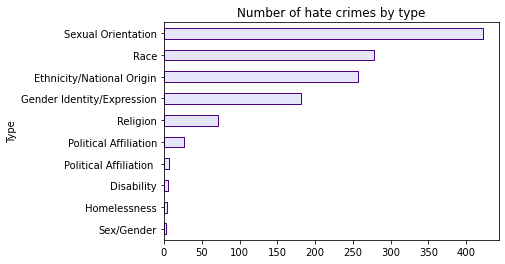

In [4]:
df['Type of Hate Bias'].value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo',
                                                         title='Number of hate crimes by type', ylabel='Type');

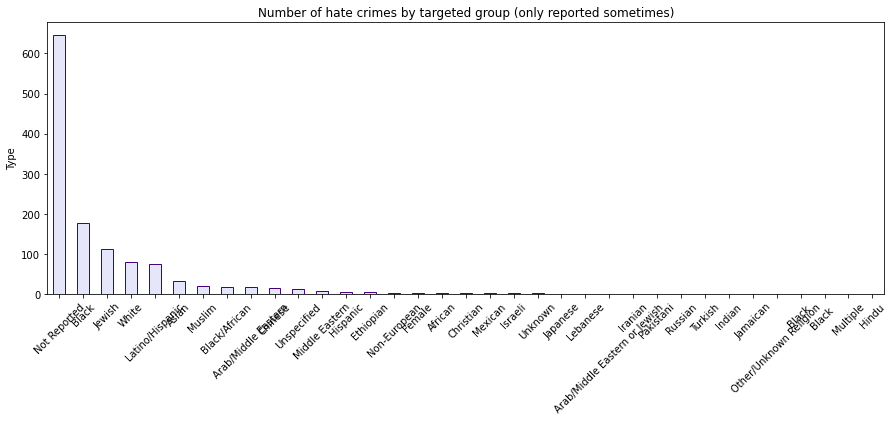

In [84]:
df['Targeted Group '].value_counts(ascending=False)\
.plot(kind='bar', color='lavender',edgecolor='indigo', figsize=(15,5),
      title='Number of hate crimes by targeted group (only reported sometimes)', ylabel='Type')
plt.xticks(rotation=45);

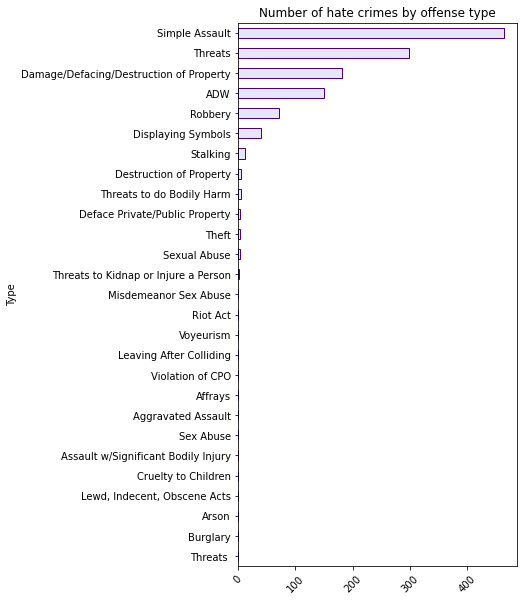

In [6]:
df['Top Offense Type'].value_counts(ascending=True)\
.plot(kind='barh', color='lavender',edgecolor='indigo', figsize=(5,10),
      title='Number of hate crimes by offense type', ylabel='Type')
plt.xticks(rotation=45);

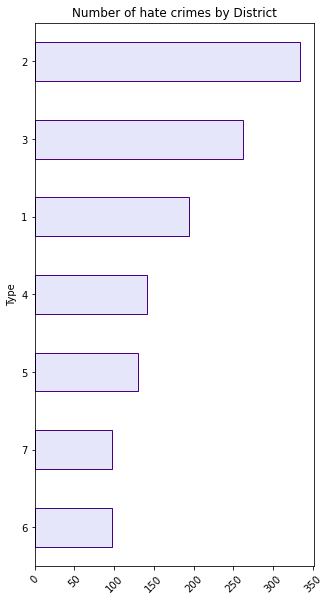

In [7]:
df['District'].value_counts(ascending=True)\
.plot(kind='barh', color='lavender',edgecolor='indigo', figsize=(5,10),
      title='Number of hate crimes by District', ylabel='Type')
plt.xticks(rotation=45);

## View some basic trending info.

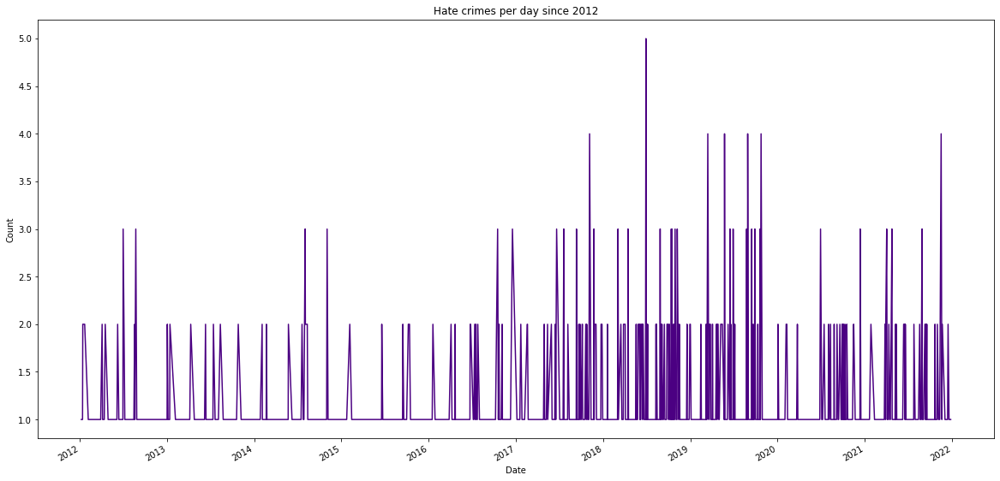

In [8]:
df['Date of Offense'].value_counts().plot(kind='line', figsize=(20,10), title='Hate crimes per day since 2012',
                                         color='indigo', ylabel='Count', xlabel='Date');

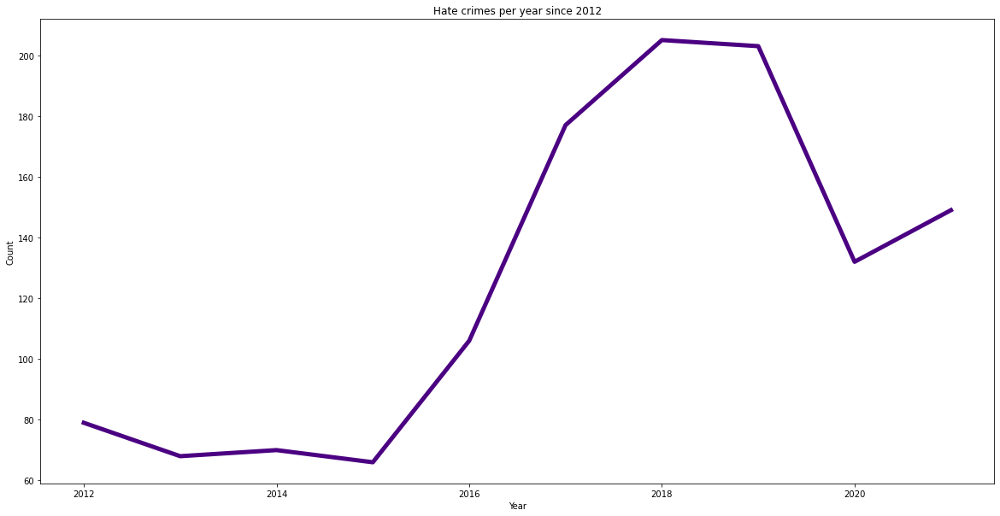

In [9]:
# need to sort by year
df['Report Year'].value_counts().sort_index().plot(kind='line', figsize=(20,10), title='Hate crimes per year since 2012',
                                          ylabel='Count', color='indigo',xlabel='Year', linewidth=5);

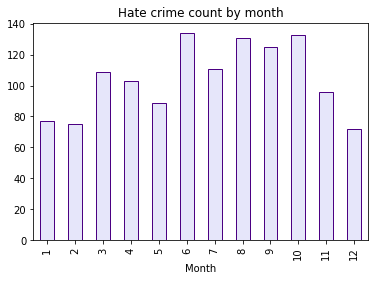

In [10]:
df.groupby(['Month'])['Month'].count().plot(kind='bar', title = 'Hate crime count by month', color='lavender',
                                           edgecolor='indigo');

show month/year combo

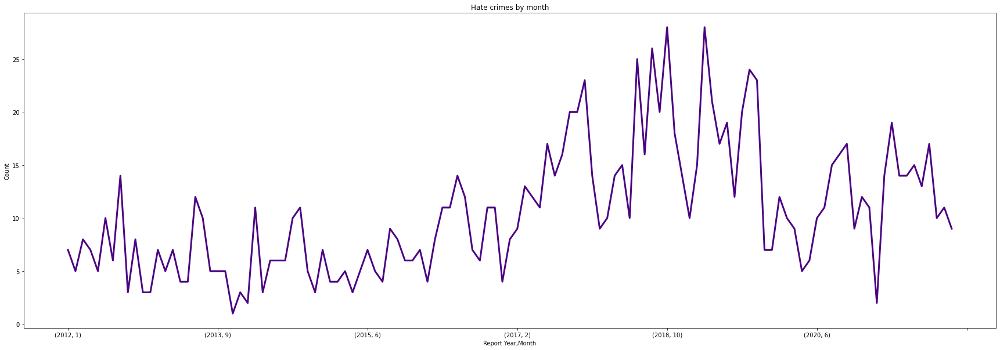

In [11]:
# show month/year rates
df.groupby(['Report Year','Month'])['CCN'].agg('count').plot(title='Hate crimes by month',figsize=(30,10),
                                                      color='indigo',ylabel = 'Count', kind='line', linewidth=3);

## Trends by crime type and targeted group

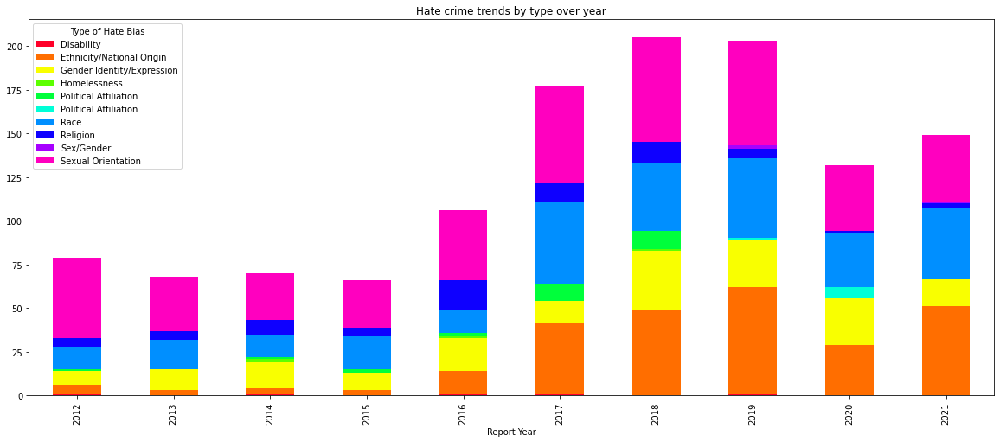

In [12]:
# # show month/year rates
# df.groupby(['Report Year','Type of Hate Bias'])['CCN'].agg('count').plot(title='Hate crimes by month',figsize=(30,10),
#                                                       color='indigo',ylabel = 'Count', kind='bar', linewidth=3);



# df.groupby(['Report Year','Type of Hate Bias'])['CCN'].agg('count')

df.groupby(['Report Year', 'Type of Hate Bias']).size().unstack().plot(kind='bar', 
                                                        title='Hate crime trends by type over year', 
                                                        stacked=True, figsize=(20,8), colormap="gist_rainbow");

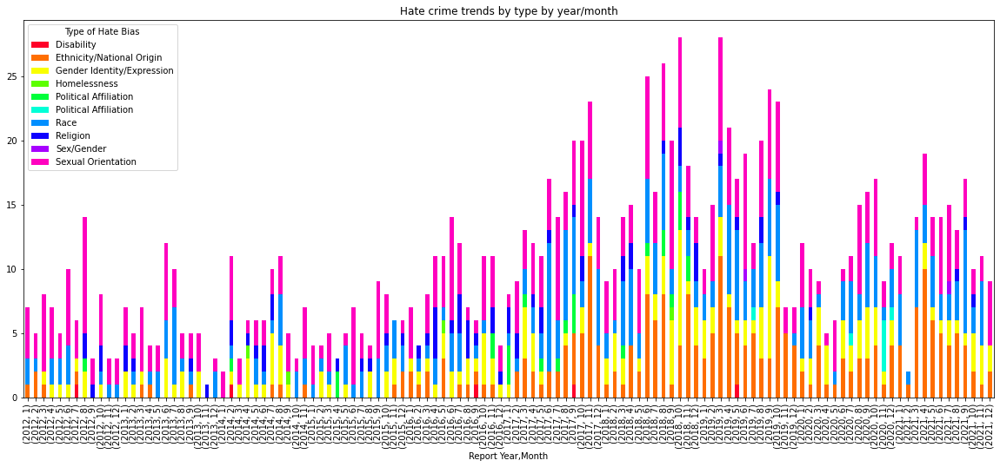

In [13]:
# this looks ugly now but could be useful
df.groupby(['Report Year', 'Month', 'Type of Hate Bias']).size().unstack().plot(kind='bar', 
                                                        title='Hate crime trends by type by year/month', 
                                                        stacked=True, figsize=(20,8), colormap="gist_rainbow");

## Hate crimes saw a large jump in 2017 in most categories. The 2016 election where Trump won, is an important date that may correspond to the jump in hate crimes.
## Ethnicity hate crimes spiked starting from late 2015.
## There were very few hate crimes in February 2021 - what happened??

## After the large jumps in 2017-2019, hate crimes decreased in 2020 - but DC was locked down after COVID, so that may help explain the drops. The numbers in 2020 and 2021 are still higher than the pre-Trump election values.

In [89]:
# targeted groups to analyze - top 10, which have 2 digits or more overall.
targeted_groups = ["Black", "Jewish","White","Latino/Hispanic","Asian","Muslim",
                   "Arab/Middle Eastern","Black/African","Chinese","Unspecified" ] # , "Not Reported"]

In [90]:
target_df = df.loc[df['Targeted Group '].isin(targeted_groups)] #.groupby(['Report Year', 'Targeted Group ']).size()

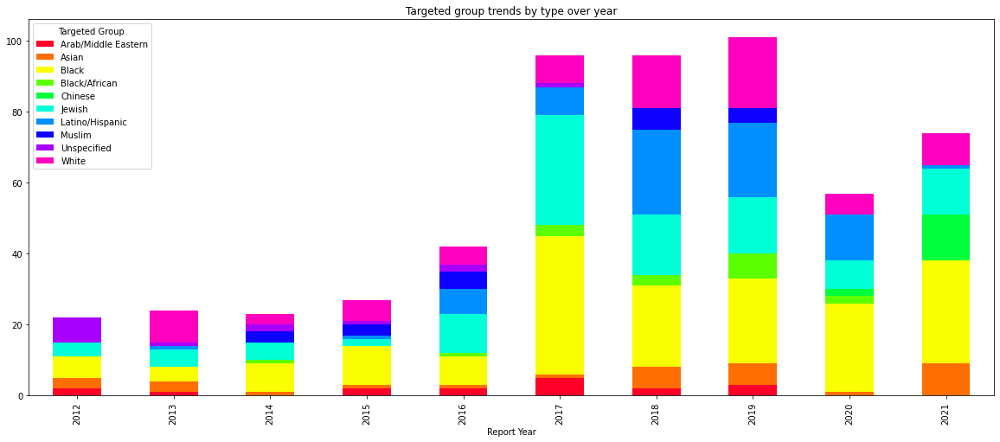

In [91]:
target_df.groupby(['Report Year', 'Targeted Group ']).size().unstack().plot(kind='bar', 
                                    title='Targeted group trends by type over year', 
                                    stacked=True, figsize=(20,8), colormap="gist_rainbow");

## See how it compares with "Not Reported" - show percentages
## We can clearly see that hate crimes against Latino/Hispanic sharply increased in 2018-2020, though had a noticeable drop in 2021. Crimes against Jewish steeply increased starting in 2017.
## Asians saw nearly no (according to the field being filled in) reports in 2020, but had a big increase in 2021 - in theme with increased anti-Asian sentiment in America after COVID.
## check data defs. are there more if there were more awareness

## Next, let's take a deeper dive and see if there are specific days/months where they had the most incidents of reported crimes or target groups.

In [17]:
# insert code here

In [18]:
# top 5 days
df['Date of Offense'].value_counts().head(5)

2018-06-29    5
2019-05-24    4
2019-08-29    4
2019-03-15    4
2019-10-24    4
Name: Date of Offense, dtype: int64

https://en.wikipedia.org/wiki/Capital_Gazette_shooting ?

In [19]:
df.loc[df['Date of Offense']=='2018-06-29']

,Date of Offense,Time of Offense,Date Offense Reported,Report Year,Month,CCN,District,Block Location,Type of Hate Bias,Targeted Group,Top Offense Type
645,2018-06-29,49,2018-06-29,2018,6,18105946,3,2300 B/O 18th St NW,Political Affiliation,NaN,ADW
646,2018-06-29,117,2018-06-29,2018,6,18105958,3,1300 B/O U St NW,Ethnicity/National Origin,Latino/Hispanic,ADW
647,2018-06-29,658,2018-06-29,2018,6,18106025,1,300 B/O D St SW,Ethnicity/National Origin,Arab/Middle Eastern,Damage/Defacing/Destruction of Property
648,2018-06-29,1817,2018-06-29,2018,6,18106333,5,1200 B/O Quincy St NE,Race,White,Simple Assault
649,2018-06-29,2145,2018-06-30,2018,6,18106702,2,3100 B/O M St NW,Ethnicity/National Origin,Jewish,Damage/Defacing/Destruction of Property


## Now let's look at how the data is by using the dc police districts

In [20]:
# load file
import json
with open('police-districts-mpd.geojson') as f:
    dc_pd = json.load(f)

### View overall hate crime counts per district

In [21]:
# make a dataframe to count up the crime types per district
district_count = df['District'].value_counts().to_frame().reset_index()
district_count = district_count.rename(columns={"index": "DISTRICT", "District": "Count"})

In [82]:
# view the graph
import plotly.express as px
fig = px.choropleth_mapbox(district_count, geojson=dc_pd, locations="DISTRICT", color='Count',
                           featureidkey="properties.DISTRICT",
                           color_continuous_scale="sunset",
                           range_color=(0, 350),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 38.9072, "lon": -77.0369},
                           opacity=0.5,
                           labels={'Count':'Count'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### View individual hate crime types by district

In [23]:
# one row per district and per crime count
# just do a couple for now, can do all in a loop later ;)
sexual_orientation_count = df['District'].loc[df['Type of Hate Bias']=='Sexual Orientation'].value_counts().to_frame().reset_index()
race_count = df['District'].loc[df['Type of Hate Bias']=='Race'].value_counts().to_frame().reset_index()

sexual_orientation_count = sexual_orientation_count.rename(columns={"index": "DISTRICT", "District": "Count"})
race_count = race_count.rename(columns={"index": "DISTRICT", "District": "Count"})

In [24]:
# sexual orientation
fig = px.choropleth_mapbox(sexual_orientation_count, geojson=dc_pd, locations="DISTRICT", color='Count',
                           featureidkey="properties.DISTRICT",
                           color_continuous_scale="sunset",
                           range_color=(0, 125),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 38.9072, "lon": -77.0369},
                           opacity=0.5,
                           labels={'Count':'Count'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [25]:
# race
fig = px.choropleth_mapbox(race_count, geojson=dc_pd, locations="DISTRICT", color='Count',
                           featureidkey="properties.DISTRICT",
                           color_continuous_scale="sunset",
                           range_color=(0, 90),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 38.9072, "lon": -77.0369},
                           opacity=0.5,
                           labels={'Count':'Count'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Try converting the given address to a coordinate
https://towardsdatascience.com/geocode-with-python-161ec1e62b89 ?

In [26]:
# !pip install geopandas --quiet
# !pip install geopy --quiet
import geopandas
import geopy
from geopy.geocoders import Nominatim

### test with a small example

In [27]:
locator = Nominatim(user_agent="myGeocoder")
location = locator.geocode("Champ de Mars, Paris, France")

In [28]:
print(location.raw)
print(location.address)
print((location.latitude, location.longitude))

{'place_id': 95556265, 'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright', 'osm_type': 'way', 'osm_id': 4208595, 'boundingbox': ['48.8522459', '48.8600801', '2.2918711', '2.303791'], 'lat': '48.85614465', 'lon': '2.297820393322227', 'display_name': 'Champ de Mars, Omer Sirwan, Quartier du Gros-Caillou, Paris 7e Arrondissement, Paris, Île-de-France, France métropolitaine, 75007, France', 'class': 'tourism', 'type': 'attraction', 'importance': 1.0080889235157509, 'icon': 'https://nominatim.openstreetmap.org/ui/mapicons//poi_point_of_interest.p.20.png'}
Champ de Mars, Omer Sirwan, Quartier du Gros-Caillou, Paris 7e Arrondissement, Paris, Île-de-France, France métropolitaine, 75007, France
(48.85614465, 2.297820393322227)


### test with a series of locations - it can even take schools :O

In [29]:
# these are the top 5 rated high schools in Chicago
top5 = ['Walter Payton College Prep',
        'northside college preparatory high school',
        'Jones College Prep',
        'Whitney Young High',
        'Lane Tech High School',
       ]

geolocator = Nominatim(user_agent="your_app_name")
dftest = pd.DataFrame(top5, columns=['school'])
dftest['location'] = dftest['school'].apply(lambda x: geolocator.geocode(x))

In [30]:
dftest

,school,location
0,Walter Payton College Prep,"(Walter Payton College Prep, 1034, North Wells..."
1,northside college preparatory high school,"(Northside College Preparatory High School, No..."
2,Jones College Prep,"(Jones College Prep, 700, South State Street, ..."
3,Whitney Young High,None
4,Lane Tech High School,"(Frank Church High School, 3608, South Milwauk..."


## test if it works with the addresses we have!
https://geopy.readthedocs.io/en/stable/#usage-with-pandas

## removing B/O and appending Washington DC seems to work, but there are edge cases that need to be reviewed.

In [31]:
# test some addresses
from geopy.extra.rate_limiter import RateLimiter
geolocator = Nominatim(user_agent="hey")
geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
location = geolocator.geocode('1600  17th St NW Washington DC')
location.latitude,location.longitude, location

(38.91125,
 -77.038588,
 Location(1600, 17th Street Northwest, Dupont Circle, Washington, District of Columbia, 20009, United States, (38.91125, -77.038588, 0.0)))

## Preprocess the addresses to avoid errors

In [32]:
# # TESTING FOR ERRORING ADDRESSES
# geolocator = Nominatim(user_agent="hey")
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
# # location = geolocator.geocode('3rd St SW Washington DC corner K St SW Washington DC')
# location = geolocator.geocode('K St SW Washington DC')
# location

In [33]:
# # try using corner instead of &
# geolocator = Nominatim(user_agent="hey")
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
# location = geolocator.geocode('3rd St SW corner K St SW Washington DC')
# location

In [34]:
## Fix malformed addresses ##
# Remove B/O and put into new column Address
df['Address'] = df['Block Location'].str.replace("B/O", '')

# Append with Washington DC
df['Address'] = df['Address'].astype(str) + ' Washington DC'

# remove 'blk of'
df['Address'] = df['Address'].str.replace('blk of', '')

# fix ones with a strange Unit
df.Address[df.Address=='Unit  O St NW Washington DC'] = 'O St NW Washington DC'
df.Address[df.Address=='Unit  M St SW Washington DC'] = 'M St SW Washington DC'
df.Address[df.Address=='Unit  M St SE Washington DC'] = 'M St SE Washington DC'
df.Address[df.Address=='Unit  Florida Ave  NE Washington DC'] = 'Florida Ave NE Washington DC'

# Addresses that contain multiple streets (with "&" typically fail)

<ipython-input-34-0f4b7bdad555>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-34-0f4b7bdad555>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-34-0f4b7bdad555>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-34-0f4b7bd

In [35]:
len(df[df['Address'].str.contains("&")])

50

In [36]:
df[df['Address'].str.contains("&")]

,Date of Offense,Time of Offense,Date Offense Reported,Report Year,Month,CCN,District,Block Location,Type of Hate Bias,Targeted Group,Top Offense Type,Address
1,2012-01-12,1722,2012-01-12,2012,1,12005834,1,3rd St SW & K St SW,Sexual Orientation,NaN,Robbery,3rd St SW & K St SW Washington DC
2,2012-01-13,1255-1258,2012-01-13,2012,1,12006285,4,Park Rd NW & Sherman Ave NW,Race,Unspecified,Simple Assault,Park Rd NW & Sherman Ave NW Washington DC
4,2012-01-14,0431-0433,2012-01-14,2012,1,12006742,3,18th St NW & Florida Ave NW,Ethnicity/National Origin,Arab/Middle Eastern,Simple Assault,18th St NW & Florida Ave NW Washington DC
13,2012-03-12,2135-2140,2012-03-12,2012,3,12034811,3,Irving St NW & Georgia Ave NW,Sexual Orientation,NaN,Robbery,Irving St NW & Georgia Ave NW Washington DC
20,2012-04-04,1300,2012-04-04,2012,4,12045820,6,E St SE & Chaplin St SE,Sexual Orientation,NaN,Simple Assault,E St SE & Chaplin St SE Washington DC
26,2012-04-29,230,2012-04-29,2012,4,12058115,2,22nd St NW & P St NW,Race,Unspecified,Damage/Defacing/Destruction of Property,22nd St NW & P St NW Washington DC
30,2012-05-16,130,2012-05-16,2012,5,12066780,1,7th St NE & H St NE,Gender Identity/Expression,NaN,Simple Assault,7th St NE & H St NE Washington DC
31,2012-05-20,1000,2012-05-20,2012,5,12069176,2,18th St NW & M St NW,Sexual Orientation,NaN,Simple Assault,18th St NW & M St NW Washington DC
36,2012-06-13,1937-1938,2012-06-13,2012,6,12082150,1,4th St NW & Pennsylvania Ave NW,Race,Unspecified,Threats,4th St NW & Pennsylvania Ave NW Washington DC
37,2012-06-22,430,2012-06-22,2012,6,12086552,4,Irving St NW & Mount Pleasant St NW,Sexual Orientation,NaN,Robbery,Irving St NW & Mount Pleasant St NW Washington DC


In [37]:
df.loc[df['Address']=='3rd St SW & K St SW Washington DC']
# Unit++M+St+SW+Washington+DC
# 1100++1st+St+NE+Washington+DC

,Date of Offense,Time of Offense,Date Offense Reported,Report Year,Month,CCN,District,Block Location,Type of Hate Bias,Targeted Group,Top Offense Type,Address
1,2012-01-12,1722,2012-01-12,2012,1,12005834,1,3rd St SW & K St SW,Sexual Orientation,NaN,Robbery,3rd St SW & K St SW Washington DC


### try updating all addresses now

In [38]:
# ## TESTING FIRST ##
# test_df = df.head(10)
# geolocator = Nominatim(user_agent="your_app_name")
# test_df['gcode'] = test_df.Address.apply(geolocator.geocode)
# # get the coordinates - HAVE TO HANDLE NONES
# # test_df['lat'] = [g.latitude for g in test_df.gcode]
# # test_df['long'] = [g.longitude for g in test_df.gcode]
# test_df['lat'] = test_df.gcode.apply(lambda x: geolocator.geocode(x).latitude if geolocator.geocode(x) != None else 'None')


In [39]:
# test_df

In [40]:
# # does not work - figure out if we need to add DC to it or something
# geolocator = Nominatim(user_agent="your_app_name")
# from geopy.extra.rate_limiter import RateLimiter
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=0.5)
# df['gcode'] = df['Address'].apply(lambda x: geolocator.geocode(x))
# # get the coordinates
# df['lat'] = [g.latitude for g in df.gcode]
# df['long'] = [g.longitude for g in df.gcode]
# # df['point'] = df['Address'].apply(lambda loc: tuple(loc.point) if loc else None)
# df

In [41]:
# df['latitude'] = df['test_address'].apply(lambda x: (x.latitude, x.longitude))

# df['latitude'] = df['Address'].apply(geolocator.geocode).apply(lambda x: x.latitude)
# df['longitude'] = df['Address'].apply(geolocator.geocode).apply(lambda x: x.longitude)

# Police use of force from 2020 in DC

In [121]:
# load 2020 use of force dataset
force = pd.read_csv('UofF_external_2020_public_214.csv')

In [122]:
force.head()

,IS_ID,IncidentDate,IncidentTime,IncidentDistrict,CaseStatus,DateClosed,uof_type,disposition,department_action,Officer_id,OfficerAssignment,OfficerGender,OfficerRace,year_force,subject_age,subject_race,subject_gender,serious,CD,animal
0,902a2368ae1c486481892a1ca58eda5f,1/1/2020,1:25,6D,Closed,1/28/2020,Pointing of a Firearm,Tracking Only,NaN,a1220a5c-1a7b-4cc5-9774-8be4531f8c58,6D,Male,Black/African American,4,26,Black/African American,Male,0.0,0,0
1,6747630f3f3e4449a04ca0ca984a9b84,1/1/2020,2:20,7D,Closed,2/24/2020,Tactical Takedown: No Injury or Complaint of Pain,Tracking Only,NaN,bd982c85-3d86-4420-aaff-d66a474a9f17,7D,Male,Black/African American,7,36,Black/African American,Male,0.0,0,0
2,6747630f3f3e4449a04ca0ca984a9b84,1/1/2020,2:20,7D,Closed,2/24/2020,Tactical Takedown: No Injury or Complaint of Pain,Tracking Only,NaN,94f98225-6e8c-423a-bff2-8346758719fb,7D,Male,White/Caucasian,15,36,Black/African American,Male,0.0,0,0
3,6747630f3f3e4449a04ca0ca984a9b84,1/1/2020,2:20,7D,Closed,2/24/2020,Tactical Takedown: No Injury or Complaint of Pain,Tracking Only,NaN,305f353a-760c-434f-bac8-b7b65a95087e,7D,Male,White/Caucasian,2,36,Black/African American,Male,0.0,0,0
4,6747630f3f3e4449a04ca0ca984a9b84,1/1/2020,2:20,7D,Closed,2/24/2020,Hand & Straight Strikes,Justified - Within Department Policy,NaN,760981c0-ea5a-4624-a75a-9c8ec351498a,7D,Male,Black/African American,14,36,Black/African American,Male,0.0,0,0


### Preprocessing

In [75]:
# convert to datetime
force['IncidentDate'] = pd.to_datetime(force['IncidentDate'] )

# Remove the D in the districts since the geojsons only need the number
force['IncidentDistrict'] = force['IncidentDistrict'].str.replace('D', '') # remove D

### View basic stats about the dataset.
# wait whats the demographics of DC

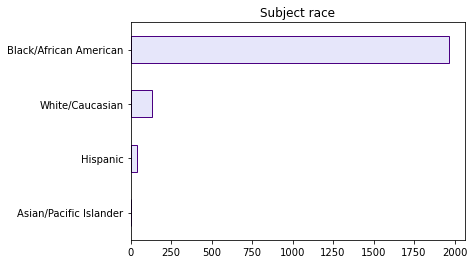

In [44]:
force.subject_race.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', title='Subject race');

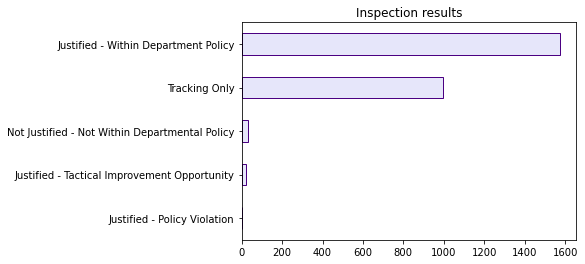

In [45]:
force.disposition.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', title = 'Inspection results');

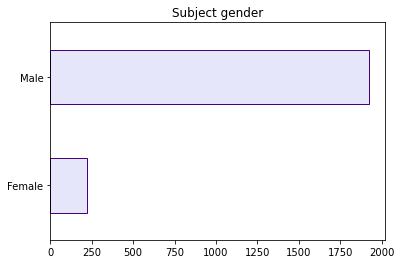

In [46]:
force.subject_gender.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', title='Subject gender');

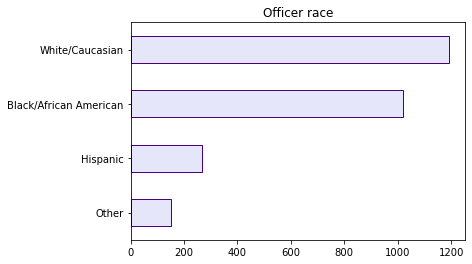

In [47]:
force.OfficerRace.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', 
                                                    title='Officer race');

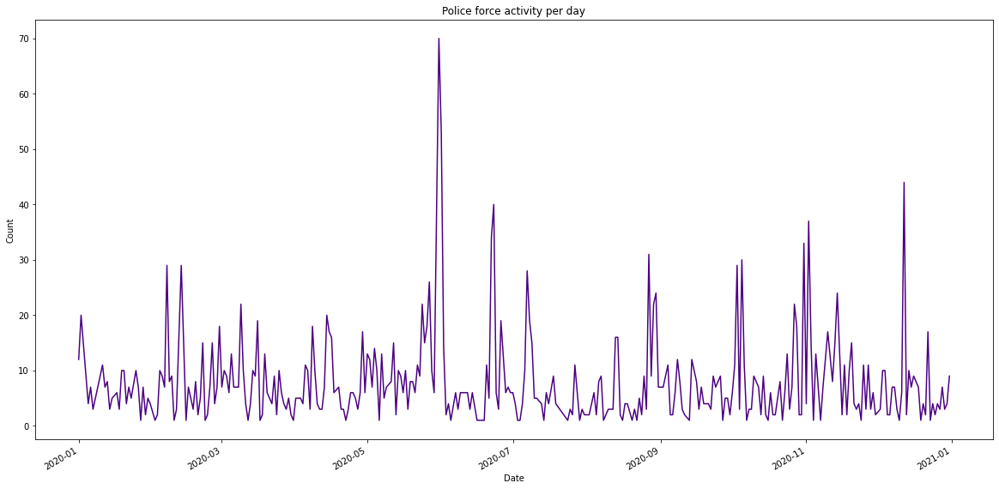

In [58]:
force['IncidentDate'].value_counts().plot(kind='line', figsize=(20,10), title='Police force activity per day',
                                         color='indigo', ylabel='Count', xlabel='Date');

We can see there are various spikes, especially in June. This is likely related to the George Floyd protests across the country which occurred from 28 May - 23 June in Washington, DC. Let's check the top dates below.

In [60]:
force['IncidentDate'].value_counts(ascending=False).head(15)

2020-05-31    70
2020-06-01    53
2020-12-12    44
2020-06-23    40
2020-11-02    37
2020-06-22    34
2020-10-31    33
2020-08-27    31
2020-10-05    30
2020-10-03    29
2020-02-07    29
2020-02-13    29
2020-07-07    28
2020-05-27    26
2020-08-30    24
Name: IncidentDate, dtype: int64

4 of the top 6 days with police force occurred during the George Floyd protests.

The third highest was 12 December - what was that? And also 2 November.

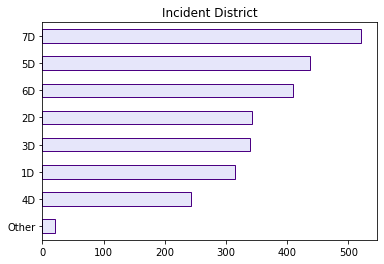

In [61]:
force.IncidentDistrict.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', 
                                                    title='Incident District');

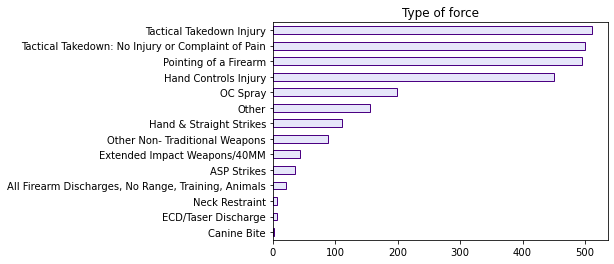

In [62]:
force.uof_type.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', 
                                                    title='Type of force');

Let's see if different methods were used for different races or by different races of officers?

In [74]:
force.groupby(['uof_type','OfficerRace']).size().sort_values(ascending=False).to_frame()

0
uof_type                                           OfficerRace                
Pointing of a Firearm                              White/Caucasian         257
Tactical Takedown: No Injury or Complaint of Pain  Black/African American  222
Tactical Takedown Injury                           White/Caucasian         215
                                                   Black/African American  212
Tactical Takedown: No Injury or Complaint of Pain  White/Caucasian         188
Hand Controls Injury                               White/Caucasian         187
Pointing of a Firearm                              Black/African American  183
Hand Controls Injury                               Black/African American  170
OC Spray                                           White/Caucasian         117
Other                                              White/Caucasian          73
Hand Controls Injury                               Hispanic                 64
Other                                              Black/African American   63
Tactical Takedown: No Injury or Complaint of Pain  Hispanic                 58
Other Non- Traditional Weapons                     White/Caucasian          55
Hand & Straight Strikes                            Black/African American   53
OC Spray                                           Black/African American   51
Tactical Takedown Injury                           Hispanic                 49
Hand & Straight Strikes                            White/Caucasian          40
Pointing of a Firearm                              Hispanic                 39
Tactical Takedown Injury                           Other                    35
Tactical Takedown: No Injury or Complaint of Pain  Other                    32
Extended Impact Weapons/40MM                       White/Caucasian          29
Hand Controls Injury                               Other                    29
Other Non- Traditional Weapons                     Black/African American   24
OC Spray                                           Hispanic                 20
ASP Strikes                                        Black/African American   18
Pointing of a Firearm                              Other                    17
ASP Strikes                                        White/Caucasian          14
Hand & Straight Strikes                            Hispanic                 13
OC Spray                                           Other                    11
Extended Impact Weapons/40MM                       Black/African American   10
Other                                              Hispanic                 10
All Firearm Discharges, No Range, Training, Ani... White/Caucasian          10
Other                                              Other                     9
Other Non- Traditional Weapons                     Hispanic                  6
All Firearm Discharges, No Range, Training, Ani... Black/African American    6
Hand & Straight Strikes                            Other                     5
Extended Impact Weapons/40MM                       Other                     4
Other Non- Traditional Weapons                     Other                     4
ECD/Taser Discharge                                Black/African American    3
All Firearm Discharges, No Range, Training, Ani... Hispanic                  3
Neck Restraint                                     White/Caucasian           3
ECD/Taser Discharge                                White/Caucasian           3
Neck Restraint                                     Black/African American    3
Canine Bite                                        White/Caucasian           2
All Firearm Discharges, No Range, Training, Ani... Other                     2
ASP Strikes                                        Other                     2
                                                   Hispanic                  2
Neck Restraint                                     Hispanic                  1
Extended Impact Weapons/40MM                    

In [70]:
force.groupby(['subject_race','uof_type']).size().sort_values(ascending=False).to_frame()

0
subject_race           uof_type                                               
Black/African American Tactical Takedown Injury                            444
                       Tactical Takedown: No Injury or Complaint of Pain   440
                       Pointing of a Firearm                               410
                       Hand Controls Injury                                381
                       Hand & Straight Strikes                             101
                       OC Spray                                             70
                       Other                                                60
White/Caucasian        Tactical Takedown: No Injury or Complaint of Pain    39
                       Pointing of a Firearm                                36
Black/African American ASP Strikes                                          33
White/Caucasian        Tactical Takedown Injury                             23
Black/African American All Firearm Discharges, No Range, Training, Ani...   17
White/Caucasian        Hand Controls Injury                                 17
Hispanic               Pointing of a Firearm                                16
                       Tactical Takedown: No Injury or Complaint of Pain    11
Black/African American Neck Restraint                                        5
White/Caucasian        Hand & Straight Strikes                               4
                       OC Spray                                              3
Hispanic               Tactical Takedown Injury                              3
Asian/Pacific Islander Pointing of a Firearm                                 3
Black/African American ECD/Taser Discharge                                   3
Hispanic               Hand Controls Injury                                  2
                       Hand & Straight Strikes                               2
White/Caucasian        Other                                                 2
                       Extended Impact Weapons/40MM                          2
Black/African American Extended Impact Weapons/40MM                          2
White/Caucasian        Other Non- Traditional Weapons                        1
                       Neck Restraint                                        1
Asian/Pacific Islander OC Spray                                              1
White/Caucasian        ECD/Taser Discharge                                   1
                       All Firearm Discharges, No Range, Training, Ani...    1
                       ASP Strikes                                           1
Hispanic               Other                                                 1
                       ECD/Taser Discharge                                   1
Black/African American Canine Bite                                           1
Hispanic               Neck Restraint                                        1

In [72]:
# groupby different order
force.groupby(['uof_type','subject_race']).size().sort_values(ascending=False).to_frame()

,,0
uof_type,subject_race,
Tactical Takedown Injury,Black/African American,444
Tactical Takedown: No Injury or Complaint of Pain,Black/African American,440
Pointing of a Firearm,Black/African American,410
Hand Controls Injury,Black/African American,381
Hand & Straight Strikes,Black/African American,101
OC Spray,Black/African American,70
Other,Black/African American,60
Tactical Takedown: No Injury or Complaint of Pain,White/Caucasian,39
Pointing of a Firearm,White/Caucasian,36


Look at more info about this later. Black people had more Tactical Takedown Injuries than the rest, but they also comprise most the population of the dataset.

In [73]:
force.groupby(['uof_type','subject_gender']).size().sort_values(ascending=False).to_frame()

,,0
uof_type,subject_gender,
Tactical Takedown: No Injury or Complaint of Pain,Male,441
Tactical Takedown Injury,Male,423
Pointing of a Firearm,Male,419
Hand Controls Injury,Male,345
Hand & Straight Strikes,Male,100
OC Spray,Male,70
Other,Male,58
Hand Controls Injury,Female,55
Tactical Takedown: No Injury or Complaint of Pain,Female,51


### Maps

In [79]:
# make a dataframe to count up the crime types per district
force_count = force['IncidentDistrict'].value_counts().to_frame().reset_index()
force_count = force_count.rename(columns={"index": "DISTRICT", "IncidentDistrict": "Count"})

In [81]:
# view the graph
import plotly.express as px
fig = px.choropleth_mapbox(force_count, geojson=dc_pd, locations="DISTRICT", color='Count',
                           featureidkey="properties.DISTRICT",
                           color_continuous_scale="sunset",
                           range_color=(0, 550),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 38.9072, "lon": -77.0369},
                           opacity=0.5,
                           labels={'Count':'Count'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Stop incidents testing

In [103]:
stops = pd.read_csv('Stop_incidents.csv', low_memory=False)

In [107]:
stops.sample(5)

,OBJECTID,CCN_ANONYMIZED,STOP_TYPE,STOP_DATE,STOP_TIME,STOP_LOCATION,STOP_DISTRICT,STOP_DURATION_MINS,STOP_REASON_NONTICKET,STOP_REASON_HARBOR,...,ETHNICITY,AGE,ARREST_DATE,DATETIME,GIS_ID,GLOBALID,CREATOR,CREATED,EDITOR,EDITED
88930,88931,NaN,Ticket Only,2020/12/04 05:00:00+00,1899/12/30 05:40:00+00,2ND ST NW,1D,10.0,NaN,NaN,...,Black,39,NaN,2020/12/04 05:40:00+00,Stop_Incidents_88931,{B1770648-BE86-4248-BDA1-6296913F565C},NaN,NaN,NaN,NaN
187243,187260,NaN,Ticket Only,2021/05/21 04:00:00+00,1899/12/30 15:07:00+00,1000 BLOCK OF BLADENSBURG RD NE,5D,25.0,NaN,NaN,...,Black,34,NaN,2021/05/21 14:07:00+00,Stop_Incidents_16128,{6A945693-5990-46D0-8757-97BD4D4B7448},JLAY,2021/12/04 00:49:43+00,JLAY,2021/12/04 00:49:43+00
19452,19453,0xDA0E2A2BE3AA754B2907D298B6B3687AE8AA82B28F67...,Non-ticket Stop,2019/10/19 04:00:00+00,1899/12/30 07:55:00+00,"1200 BLOCK OF NEW YORK AVENUE NW WASHINGTON, D...",2D,5.0,Call for service,NaN,...,Black,65,2019/10/19 04:00:00+00,2019/10/19 06:55:00+00,Stop_Incidents_19453,{590427D3-6511-42BD-A10E-24651BCA06D0},NaN,NaN,NaN,NaN
160417,160434,0xF4A695F5392141173DCF39101173A39E3E16F7CF3BAC...,Non-ticket Stop,2021/01/13 05:00:00+00,1899/12/31 01:45:00+00,400 BLOCK OF MASSACHUSETTS AVENUE NW WASHINGTO...,1D,20.0,Information obtained from witnesses or informa...,NaN,...,White,34,2021/01/13 05:00:00+00,2021/01/14 01:45:00+00,Stop_Incidents_4918,{9BB2E07F-1976-4F33-A061-F5B87C75AC8A},JLAY,2021/12/04 00:48:44+00,JLAY,2021/12/04 00:48:44+00
33353,33354,NaN,Ticket Only,2019/08/10 04:00:00+00,1899/12/30 14:19:00+00,3RD ST TUNNEL NW,1D,10.0,NaN,NaN,...,Black,23,NaN,2019/08/10 13:19:00+00,Stop_Incidents_33354,{4955A673-E58B-44F7-9B95-84C08C79A9BC},NaN,NaN,NaN,NaN


In [104]:
stops.columns

Index(['OBJECTID', 'CCN_ANONYMIZED', 'STOP_TYPE', 'STOP_DATE', 'STOP_TIME',
       'STOP_LOCATION', 'STOP_DISTRICT', 'STOP_DURATION_MINS',
       'STOP_REASON_NONTICKET', 'STOP_REASON_HARBOR', 'STOP_REASON_TICKET',
       'PERSON_SEARCH_PAT_DOWN', 'PROPERTY_SEARCH_PAT_DOWN',
       'PERSON_SEARCH_CONSENT', 'PERSON_SEARCH_PROB_CAUSE',
       'PERSON_PROT_PAT_DOWN', 'PERSON_SEARCH_WARRANT',
       'PROPERTY_SEARCH_CONSENT', 'PROPERTY_SEARCH_PROB_CAUSE',
       'PROPERTY_PROT_PAT_DOWN', 'PROPERTY_SEARCH_WARRANT',
       'PERSON_SEARCH_REA_CONSENT', 'PERSON_SRCH_PROB_CAUSE',
       'PERSON_PAT_DOWN_REASON', 'PERSON_SRCH_REASON_WARRANT',
       'PROP_SRCH_REASON_CONSENT', 'PROP_SRCH_PROB_CAUSE',
       'PROP_PAT_DOWN_REASON', 'PROP_SRCH_REASON_WARRANT',
       'PROPERTY_SRCH_OBJ_CONSENT', 'PROP_SRCH_OBJ_PROB_CAUSE',
       'PROP_PAT_DOWN_OBJ', 'PROP_SRCH_OBJ_WARRANT',
       'PERSON_SRCH_OBJ_SEIZED_CON', 'PERSON_SRCH_OBJ_PROB_CAUSE',
       'PER_PRO_PAT_DOWN_OBJ_SEIZE', 'PERSON_SRCH_OBJ_SEI

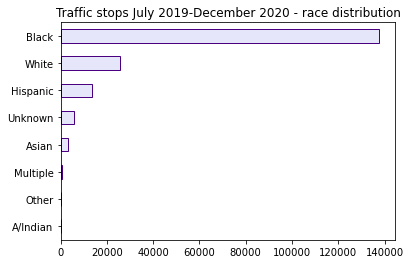

In [102]:
stops.ETHNICITY.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', title = 
                                                  'Traffic stops July 2019-December 2020 - race distribution');

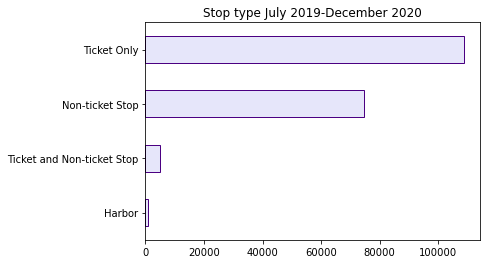

In [106]:
stops.STOP_TYPE.value_counts(ascending=True).plot(kind='barh', color='lavender',edgecolor='indigo', title = 
                                                  'Stop type July 2019-December 2020');

In [120]:
stops.STOP_REASON_NONTICKET.value_counts()

Call for service                                                                                                                                                                                                                                                            21422
Traffic violation                                                                                                                                                                                                                                                            8197
Individual<U+0092>s actions                                                                                                                                                                                                                                                  6794
Warrant/court order                                                                                                                                                               